# Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---

## Camera Calibration

To correctly display the size and shapes of 3d objects we first have to take into account the distortion inherent to the camera's setting. We start by calculating the distortion coefficients by looking at images of pre-defined checkboard patterns:

In [1]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib.animation
from matplotlib import rcParams
import os
%matplotlib inline

rcParams['axes.titlepad'] = 20 
rcParams['xtick.labelsize'] = 20 # fontsize of the tick labels
rcParams['ytick.labelsize'] = 20 # fontsize of the tick labels
rcParams['figure.subplot.hspace'] = 0.3 # fontsize of the tick labels
rcParams["animation.html"] = "html5"

In [2]:

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
        cv2.imshow('img',img)
        cv2.waitKey(500)

cv2.destroyAllWindows()

In the previous step we searched for checkboard corners using cv2's built-int *drawChessboardCorners* function. Next we will apply *calibrateCamera* on the object points and corresponding image points to find the matrices used to undistort images produced with our camera

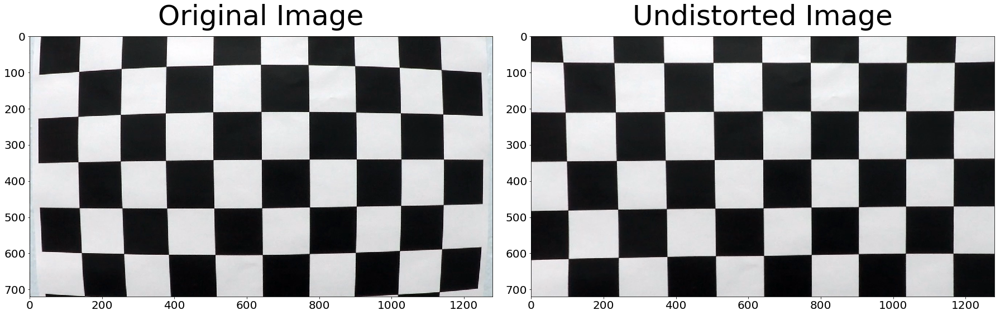

In [3]:
def cal_undistort(img, objpoints, imgpoints):
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img.shape[1:], None, None)
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    return undist


image=cv2.imread(images[0])
undistorted = cal_undistort(image, objpoints, imgpoints)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(undistorted)
ax2.set_title('Undistorted Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=2.0, bottom=0.0)

Let's clean up the cal_undistort function by using the calibration parameter as global variables to make it easier to use later on:

In [4]:
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img.shape[1:], None, None)
def undistort_image(img):
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    return undist

## Lane Detection Pipeline

Now that the camera is correctly calibrated, we can have a look at some undistorted test images:

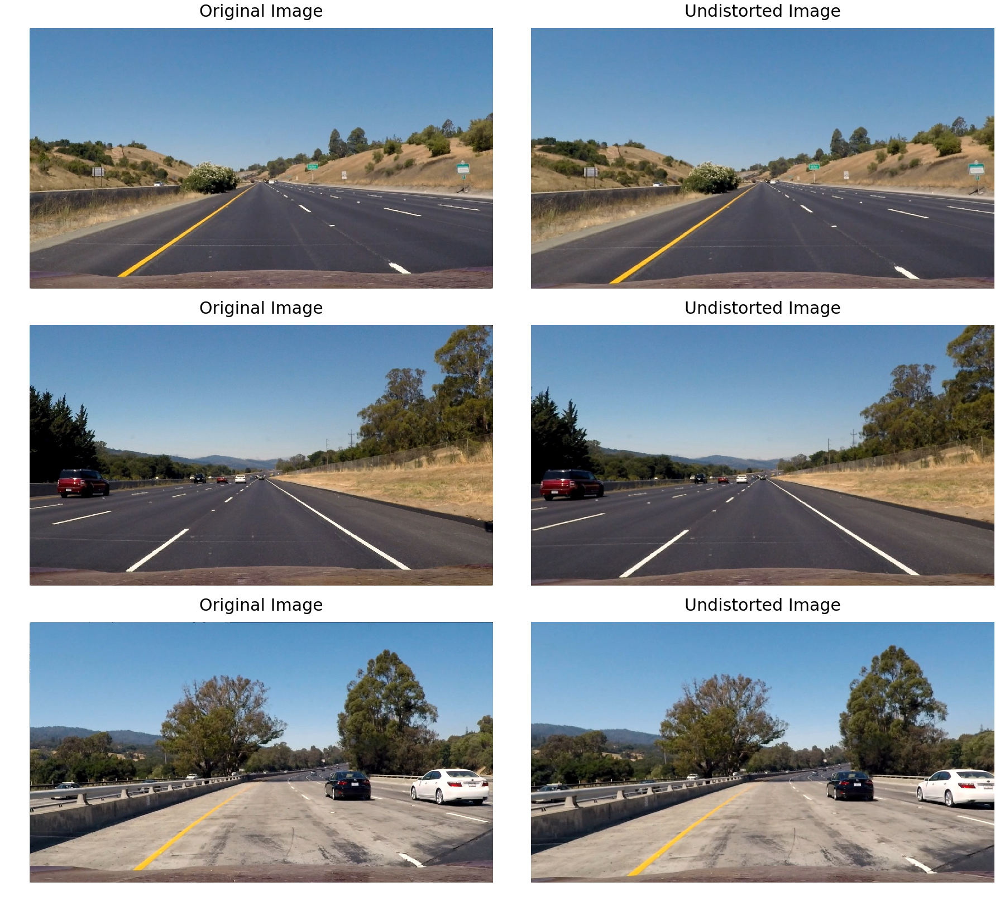

In [5]:
n=3
test_images=os.listdir("test_images/")
titles = ["Original Image", "Undistorted Image"]
fig, ax = plt.subplots(n,2,figsize=(24,24))
fig.tight_layout()

for i in range(0, n):
    image=mpimg.imread("test_images/"+test_images[i])
    undistorted = undistort_image(image)
    ax[i][0].imshow(image)
    ax[i][0].set_title(titles[0], fontsize=30)
    ax[i][0].axis('off')
    ax[i][1].imshow(undistorted)
    ax[i][1].set_title(titles[1], fontsize=30)
    ax[i][1].axis('off')

plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.show()

## Gradients and Color Spaces
In the following, we will apply a series of thresholding and color transformations to isolate the lane markings. In the end we will try to stack the lane lines we get from different algorithms in order to obtain a more robust identification of the lane markings.

### Sobel transform
See https://github.com/HandMi/CarND-ImageThresholding for further analysis of [Sobel derivatives](https://docs.opencv.org/2.4.13.7/doc/tutorials/imgproc/imgtrans/sobel_derivatives/sobel_derivatives.html). Here we are going to collect the result:

In [6]:
# Sobel pipeline
def apply_sobel(img, sobel_kernel=3, sob_thresh=(0, 255), mag_thresh=(0, 255), dir_thresh=(0, np.pi/2)):
    # Take both Sobel x and y gradients
    sobel_x = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobel_y = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    
    # Compute absolute values
    abs_sobel_x = np.absolute(sobel_x)
    abs_sobel_y = np.absolute(sobel_y)
    
    scaled_sobel_x = np.uint8(255*abs_sobel_x/np.max(abs_sobel_x))
    scaled_sobel_y = np.uint8(255*abs_sobel_y/np.max(abs_sobel_y))
    
    ## Treshold in x-direction
    binary_x = np.zeros_like(scaled_sobel_x)
    binary_x[(scaled_sobel_x >= sob_thresh[0]) & (scaled_sobel_x <= sob_thresh[1])] = 1
 
    ## Treshold in y-direction
    binary_y = np.zeros_like(scaled_sobel_y)
    binary_y[(scaled_sobel_y >= sob_thresh[0]) & (scaled_sobel_y <= sob_thresh[1])] = 1
 
    ## Magnitude threshold
    # Calculate the gradient magnitude
    abs_grad = np.sqrt(sobel_x**2 + sobel_y**2)
    # Rescale to 8 bit
    scaled_grad= np.uint8(255*abs_grad/np.max(abs_grad))
    # Create a binary image of ones where threshold is met, zeros otherwise
    binary_mag = np.zeros_like(scaled_grad)
    binary_mag[(scaled_grad >= mag_thresh[0]) & (scaled_grad <= mag_thresh[1])] = 1
    
    ## Direction threshold
    grad_dir = np.arctan2(abs_sobel_y, abs_sobel_x)
    
    # Create a binary image of ones where threshold is met, zeros otherwise
    binary_dir = np.zeros_like(grad_dir)
    binary_dir[(grad_dir >= dir_thresh[0]) & (grad_dir <= dir_thresh[1])] = 1
    
    
    # Combine all results
    bin_combined = np.zeros_like(binary_x)
    bin_combined[((binary_x == 1) & (binary_y == 1)) | ((binary_mag == 1) & (binary_dir == 1))] = 1
    return bin_combined

Let's test it on some of the test_images:

In [7]:
SOBEL_KERNEL_SIZE=7
SOBEL_THRESHOLD=(45, 255)
MAGNITUDE_THRESHOLD=(40, 360)
DIRECTIONAL_THRESHOLD=(0.3, 1.2)

In [8]:
def gaussian_blur(img, kernel_size):
    """Applies a Gaussian Noise kernel"""
    return cv2.GaussianBlur(img, (kernel_size, kernel_size), 0)

In [9]:
def sobel_filter(img):
    ret = apply_sobel(img, SOBEL_KERNEL_SIZE, SOBEL_THRESHOLD, MAGNITUDE_THRESHOLD, DIRECTIONAL_THRESHOLD)
    return ret*255

In [10]:
def grayscale(img):
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    ret = cv2.addWeighted(hls[:,:,2],0.5,img[:,:,0],0.5,0)
    return hls[:,:,2]

We apply the Sobel filter to the image created by averaging the HLS-S channel and the RGB-R channel:

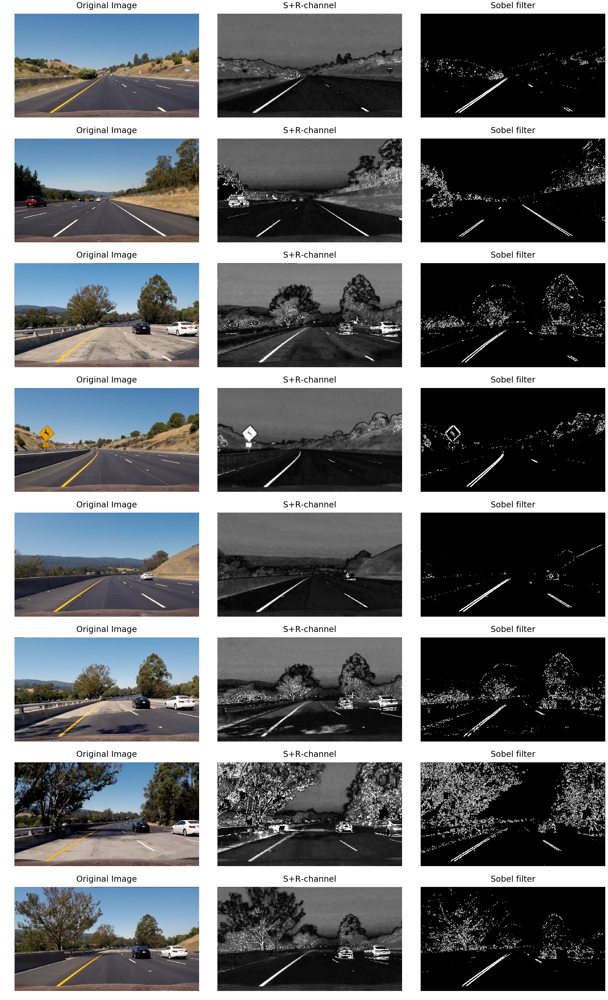

In [11]:
n=8
test_images=os.listdir("test_images/")
titles = ["Original Image", "S+R-channel", "Sobel filter"]
fig, ax = plt.subplots(n,3,figsize=(30,50))
fig.tight_layout()

for i in range(0, n):
    image = mpimg.imread("test_images/"+test_images[i])
    
    gray = grayscale(image)
    blur = gaussian_blur(gray,3)
    sobel_filtered = sobel_filter(blur)
    ax[i][0].imshow(image)
    ax[i][0].set_title(titles[0], fontsize=30)
    ax[i][0].axis('off')
    ax[i][1].imshow(gray ,'gray')
    ax[i][1].set_title(titles[1], fontsize=30)
    ax[i][1].axis('off')
    ax[i][2].imshow(sobel_filtered ,'gray')
    ax[i][2].set_title(titles[2], fontsize=30)
    ax[i][2].axis('off')

plt.subplots_adjust(left=0., right=1, top=1.0, bottom=0.)
plt.show()

As we can see, the lane markings are clearly discernible. However, we will stack another color filtered image on top using the HSV-based filter from the first project:

In [12]:
dark_yellow = (18, 60, 90)
light_yellow = (35,255,255)
dark_white = (0, 0, 200)
light_white = (255,25,255)

In [13]:
%%capture
import helpers.color_animation
fig, ax = plt.subplots()
ani_1 = helpers.color_animation.animate_hsv_colors(fig, ax, dark_yellow, light_yellow,60)

In [14]:
ani_1

In [15]:
%%capture
fig, ax = plt.subplots()
ani_2 = helpers.color_animation.animate_hsv_colors(fig, ax, dark_white, light_white,60)

In [16]:
ani_2

In [17]:
def hsv_color_filter(image):
    hsv = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
    image_yellow = cv2.inRange(hsv, dark_yellow, light_yellow)
    image_white = cv2.inRange(hsv, dark_white, light_white)
    ret_image = image_white+image_yellow
    return ret_image

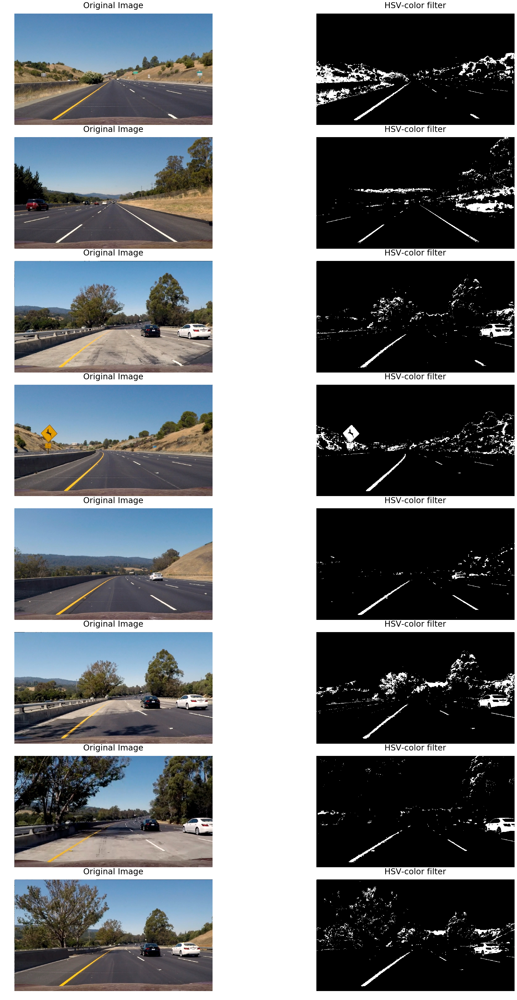

In [18]:
n=8
test_images=os.listdir("test_images/")
titles = ["Original Image",  "HSV-color filter"]
fig, ax = plt.subplots(n,2,figsize=(30,50))
fig.tight_layout()

for i in range(0, n):
    image = mpimg.imread("test_images/"+test_images[i])
    filtered = hsv_color_filter(image)
    ax[i][0].imshow(image)
    ax[i][0].set_title(titles[0], fontsize=30)
    ax[i][0].axis('off')
    ax[i][1].imshow(filtered ,'gray')
    ax[i][1].set_title(titles[1], fontsize=30)
    ax[i][1].axis('off')

plt.subplots_adjust(left=0., right=1, top=1.0, bottom=0.)
plt.show()

In [19]:
def apply_filter(image):
    gray = grayscale(image)
    blur = gaussian_blur(gray,3)
    sobel = sobel_filter(blur)
    hsv_color_mask = hsv_color_filter(image)
    ret = cv2.addWeighted(sobel,0.5,hsv_color_mask,0.5,0)
    return ret

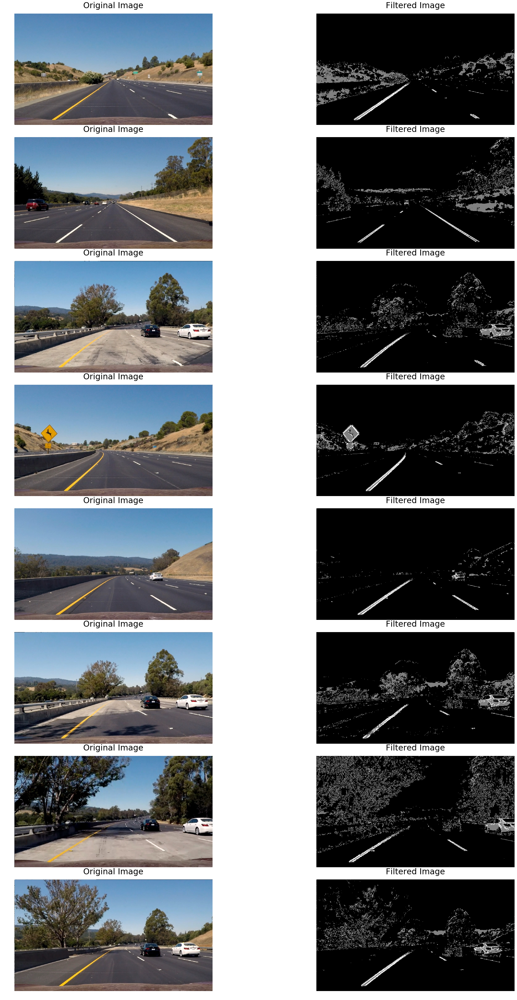

In [20]:
n=8
test_images=os.listdir("test_images/")
titles = ["Original Image",  "Filtered Image"]
fig, ax = plt.subplots(n,2,figsize=(30,50))
fig.tight_layout()

for i in range(0, n):
    image = mpimg.imread("test_images/"+test_images[i])
    filtered = apply_filter(image)
    ax[i][0].imshow(image)
    ax[i][0].set_title(titles[0], fontsize=30)
    ax[i][0].axis('off')
    ax[i][1].imshow(filtered ,'gray')
    ax[i][1].set_title(titles[1], fontsize=30)
    ax[i][1].axis('off')

plt.subplots_adjust(left=0., right=1, top=1.0, bottom=0.)
plt.show()

In the filtered image pixels that were detected by both filters are white, while pixels that were only detected by one of the filters are depicted as gray. In the following we will turn it into a binary image:

In [21]:
def apply_filter(image):
    gray = grayscale(image)
    blur = gaussian_blur(gray,3)
    sobel = sobel_filter(blur)
    hsv_color_mask = hsv_color_filter(image)
    binary = np.zeros_like(sobel)
    binary[(hsv_color_mask >= 1) | (sobel >=1)] = 1
    return binary

Next we are going to apply our filter to a warp image of the road.

## Perspective Transform

We are going to manually select a region which should be a warped to a rectangle in the rectified image. To this end, we are going to examine on of the straight line test images:

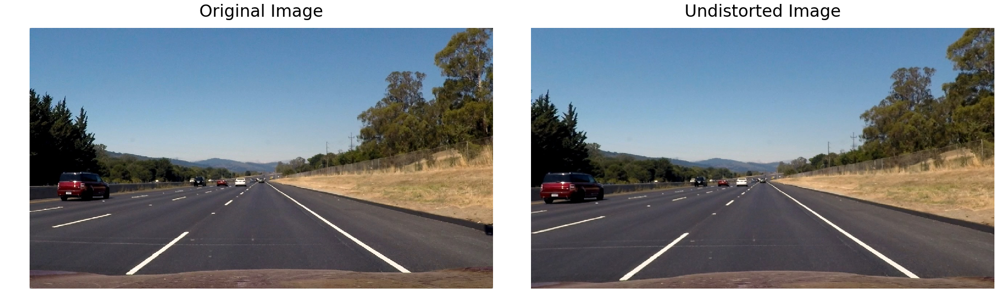

False

In [22]:
test_images=os.listdir("test_images/")
titles = ["Original Image", "Undistorted Image"]
fig, ax = plt.subplots(1,2,figsize=(24,24))
fig.tight_layout()

image=mpimg.imread("test_images/straight_lines2.jpg")
undistorted = undistort_image(image)
ax[0].imshow(image)
ax[0].set_title(titles[0], fontsize=30)
ax[0].axis('off')
ax[1].imshow(undistorted)
ax[1].set_title(titles[1], fontsize=30)
ax[1].axis('off')

plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.show()
cv2.imwrite('output_images/straight_undistorted.jpg',cv2.cvtColor(undistorted, cv2.COLOR_RGB2BGR))

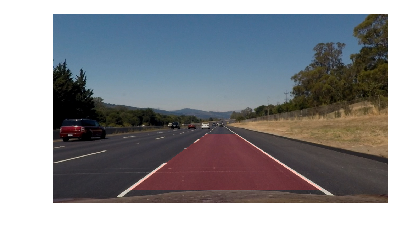

In [23]:
mask = np.zeros_like(image)
#define region for image warp
vertices = np.float32([[[287,670],[583,458],[701,458],[1031,670]]])
lane_region=cv2.fillPoly(mask,vertices.astype(int),(255,0,0))
fig,ax=plt.subplots()
ax.imshow(undistorted)
ax.imshow(lane_region,alpha=0.2, cmap="RdBu")
ax.axis('off')
plt.show()

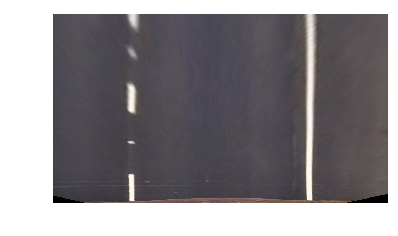

In [24]:
destination = np.float32([[[300,700],[300,20],[980,20],[980,700]]])
M = cv2.getPerspectiveTransform(vertices, destination)
warped = cv2.warpPerspective(undistorted, M, undistorted.shape[1::-1], flags=cv2.INTER_AREA)
mask = np.zeros_like(undistorted)
lane_region=cv2.fillPoly(mask,destination.astype(int),(255,0,0))
fig,ax=plt.subplots()
ax.imshow(warped)
ax.axis('off')
plt.savefig('lane_region')
plt.show()

Let's cross-check with the second straight line picture:

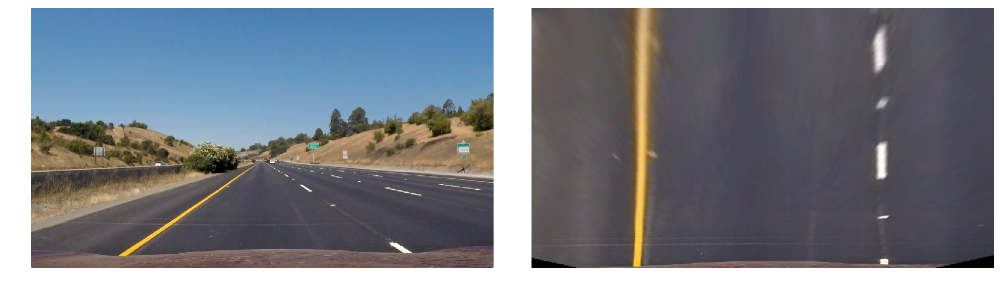

In [25]:
image=mpimg.imread("test_images/straight_lines1.jpg")
undistorted = undistort_image(image)
warped = cv2.warpPerspective(undistorted, M, undistorted.shape[1::-1], flags=cv2.INTER_LINEAR)
fig, ax = plt.subplots(1,2,figsize=(24,24))
fig.tight_layout()
ax[0].imshow(image)
ax[0].axis('off')
ax[1].imshow(warped)
ax[1].axis('off')
plt.show()

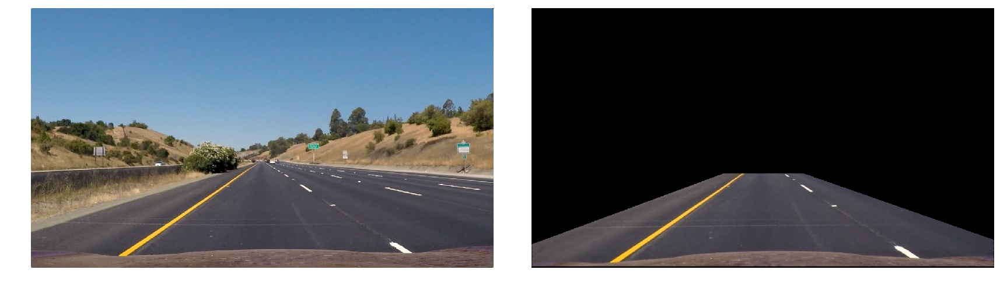

In [26]:
warped_back=cv2.warpPerspective(warped, M, undistorted.shape[1::-1], flags=cv2.INTER_LINEAR+cv2.WARP_INVERSE_MAP)
fig, ax = plt.subplots(1,2,figsize=(24,24))
fig.tight_layout()
ax[0].imshow(image)
ax[0].axis('off')
ax[1].imshow(warped_back)
ax[1].axis('off')
plt.show()

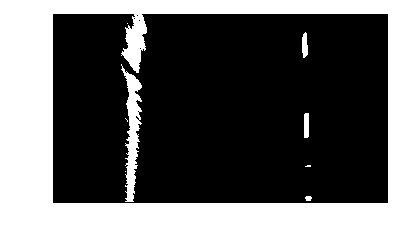

In [27]:
filtered = apply_filter(warped)
fig,ax=plt.subplots()
ax.imshow(filtered, 'gray' )
ax.axis('off')
plt.show()

The lane lines get a bit too blurry at the top of the image and cannot be found by the Sobel filter anymore. However, the HSV color filter still correctly identifies the lanes. Let's try to invert the operations:

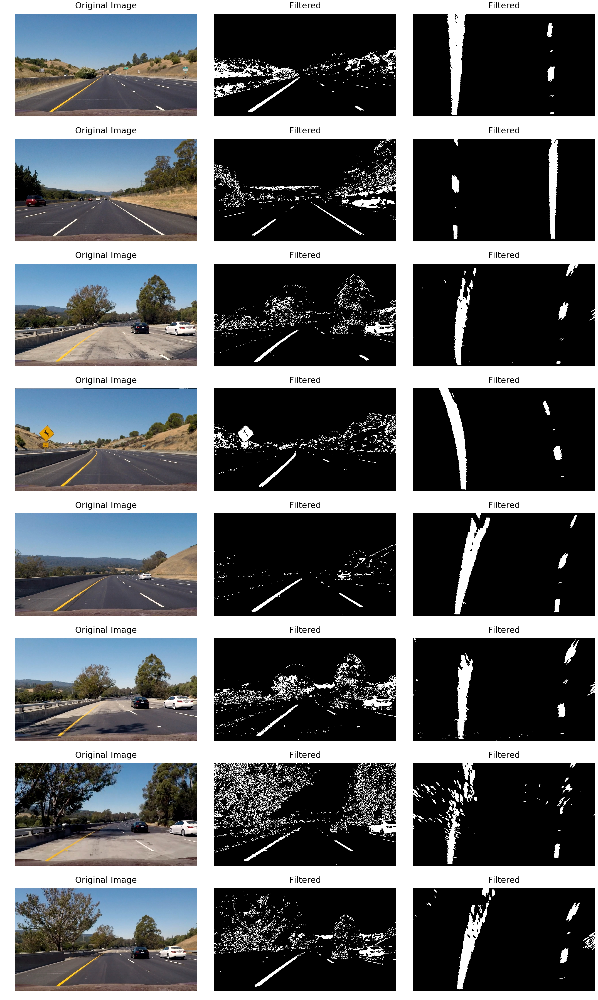

In [28]:
n=8
test_images=os.listdir("test_images/")
titles = ["Original Image",  "Filtered", "Binary Warped Image"]
fig, ax = plt.subplots(n,3,figsize=(30,50))

for i in range(0, n):
    image = mpimg.imread("test_images/"+test_images[i])
    filtered = apply_filter(image)
    warped = cv2.warpPerspective(filtered, M, filtered.shape[1::-1], flags=cv2.INTER_LINEAR)
    ax[i][0].imshow(image)
    ax[i][0].set_title(titles[0], fontsize=30)
    ax[i][0].axis('off')
    ax[i][1].imshow(filtered ,'gray')
    ax[i][1].set_title(titles[1], fontsize=30)
    ax[i][1].axis('off')
    ax[i][2].imshow(warped ,'gray')
    ax[i][2].set_title(titles[1], fontsize=30)
    ax[i][2].axis('off')    
plt.tight_layout()
plt.show()

## Sliding Windows

Next we are going to use the filtered images to produce histograms of specifc segments of the lane lines in order to produce an accurate polynomial fit of them. First we are going to approximate the base of the left and right lane by looking at the x-projected histogram of the bottom half of the image:

In [29]:
def hist(img):
    bottom_half = img[img.shape[0]//2:,:]
    histogram = np.sum(bottom_half, axis=0)
    return histogram

In [30]:
def argmedian(hist):
    total_sum = np.sum(hist)
    cumulative_sum = np.cumsum(hist)
    argmed = np.argmin(np.abs(cumulative_sum-total_sum//2))
    return argmed

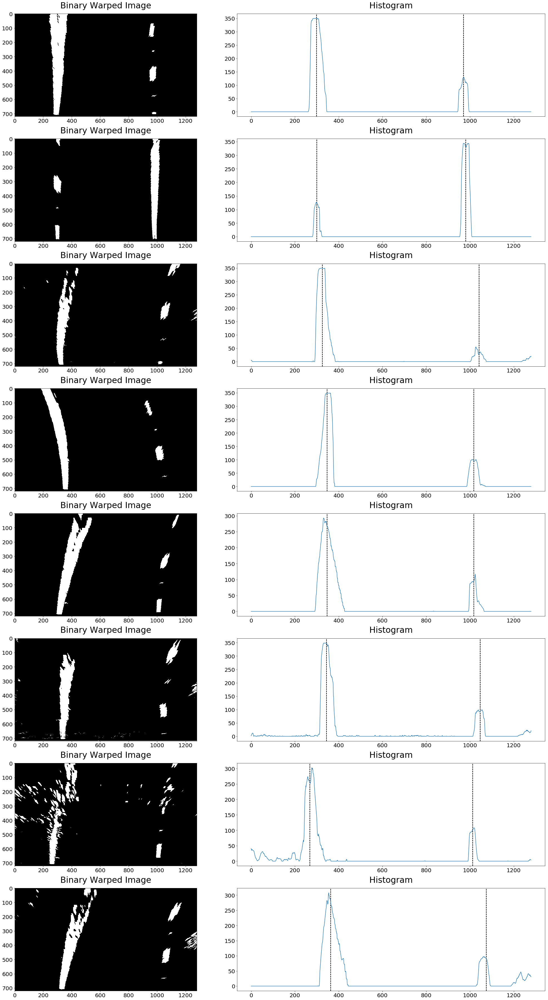

In [31]:
n=8
test_images=os.listdir("test_images/")
titles = ["Binary Warped Image",  "Histogram"]
fig, ax = plt.subplots(n,2,figsize=(30,50))

for i in range(0, n):
    image = mpimg.imread("test_images/"+test_images[i])
    filtered = apply_filter(image)
    warped = cv2.warpPerspective(filtered, M, filtered.shape[1::-1], flags=cv2.INTER_LINEAR)
    ax[i][0].imshow(warped ,'gray')
    ax[i][0].set_title(titles[0], fontsize=30)
    bottom_half = warped[warped.shape[0]//2:,:]
    histogram = np.sum(bottom_half, axis=0)
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = argmedian(histogram[:midpoint])    
    rightx_base = argmedian(histogram[midpoint:])+midpoint
    ax[i][1].axvline(leftx_base, color='k', linestyle='dashed', linewidth=2)
    ax[i][1].axvline(rightx_base, color='k', linestyle='dashed', linewidth=2)
    ax[i][1].plot(histogram)
    ax[i][1].set_title(titles[1], fontsize=30)    
plt.tight_layout()
plt.show()

Now that we have the approximate base of the lane, we can set up sliding windows. The following code is copied directly from the course material:

In [32]:
# Choose the number of sliding windows
nwindows = 10
# Set the width of the windows +/- margin
window_margin = 70
# Set minimum number of pixels found to recenter window
window_minpix = 100

In [33]:
def find_lane_pixels(binary_warped):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = argmedian(histogram[:midpoint])    
    rightx_base = argmedian(histogram[midpoint:])+midpoint

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        ### TO-DO: Find the four below boundaries of the window ###
        win_xleft_low = leftx_current - window_margin 
        win_xleft_high = leftx_current + window_margin 
        win_xright_low = rightx_current - window_margin 
        win_xright_high = rightx_current + window_margin
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(0,255,0), 2) 
        
        ### Identify the nonzero pixels in x and y within the window ###
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        ### If you found > minpix pixels, recenter next window ###
        ### (`right` or `leftx_current`) on their mean position ###
        if len(good_left_inds) > window_minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > window_minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    return leftx, lefty, rightx, righty, out_img


def fit_polynomial_windows(binary_warped):
    # Find our lane pixels first
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(binary_warped)

    ### Fit a second order polynomial to each using `np.polyfit` ###
    left_fit = np.polyfit(lefty,leftx,2)
    right_fit = np.polyfit(righty, rightx,2)

    return left_fit,right_fit

def draw_polynomial_and_windows(ax,binary_warped):
    # Find our lane pixels first
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(binary_warped)

    ### Fit a second order polynomial to each using `np.polyfit` ###
    left_fit = np.polyfit(lefty,leftx,2)
    right_fit = np.polyfit(righty, rightx,2)
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    # Plots the left and right polynomials on the lane lines
    ax.plot(left_fitx, ploty, color='yellow', linewidth=2)
    ax.plot(right_fitx, ploty, color='yellow', linewidth=2)
    return out_img

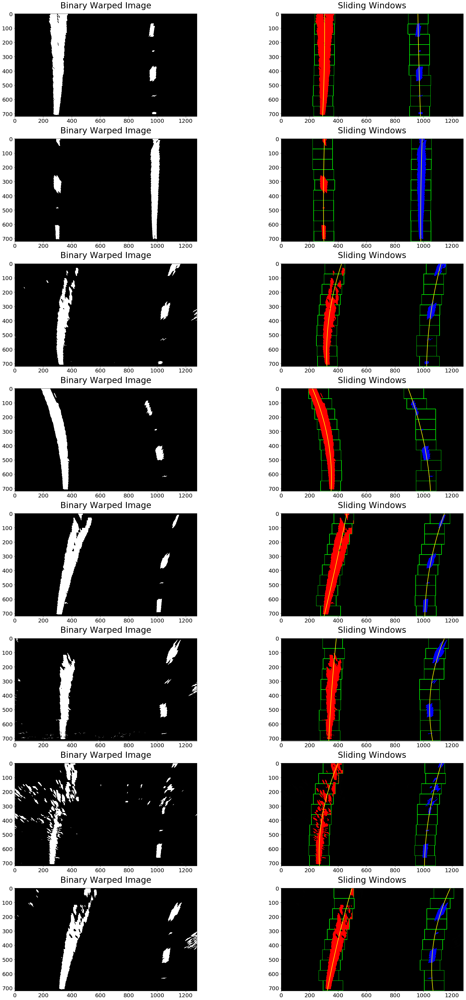

In [34]:
n=8
test_images=os.listdir("test_images/")
titles = ["Binary Warped Image",  "Sliding Windows"]
fig, ax = plt.subplots(n,2,figsize=(30,50))

for i in range(0, n):
    image = mpimg.imread("test_images/"+test_images[i])
    filtered = apply_filter(image)
    warped = cv2.warpPerspective(filtered, M, filtered.shape[1::-1], flags=cv2.INTER_LINEAR)
    ax[i][0].imshow(warped ,'gray')
    ax[i][0].set_title(titles[0], fontsize=30)
    out_img = draw_polynomial_and_windows(ax[i][1],warped)
    ax[i][1].imshow(out_img ,'gray')
    ax[i][1].set_title(titles[1], fontsize=30)    
plt.tight_layout()
plt.show()

In the next step we actually won't need the sliding windows anymore, but instead may use the already obtained polynomial to search for pixels in its vicinity:

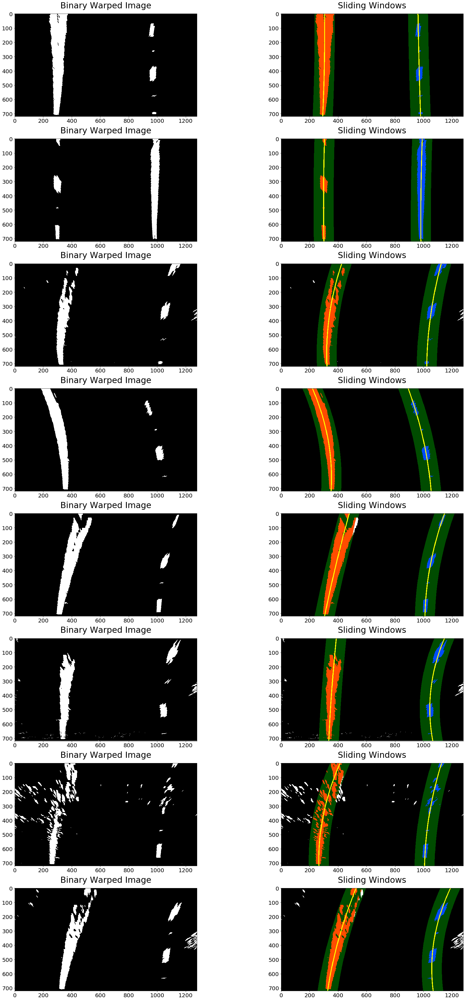

In [35]:
n=8
test_images=os.listdir("test_images/")
titles = ["Binary Warped Image",  "Sliding Windows"]
fig, ax = plt.subplots(n,2,figsize=(30,50))

def fit_polynomial(img_shape, leftx, lefty, rightx, righty):
    ### Fit a second order polynomial to each with np.polyfit() ###
    left_fit = np.polyfit(lefty,leftx,2)
    right_fit = np.polyfit(righty,rightx,2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, img_shape[0]-1, img_shape[0])
    ### Calc both polynomials using ploty, left_fit and right_fit ###
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    return left_fitx, right_fitx, ploty

def search_around_polynomial(binary_warped,left_fit,right_fit):

    # Grab activated pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    ### Set the area of search based on activated x-values ###
    ### within the +/- margin of our polynomial function ###
    ### Hint: consider the window areas for the similarly named variables ###
    ### in the previous quiz, but change the windows to our new search area ###
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - window_margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + window_margin )))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - window_margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + window_margin )))
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    # Fit new polynomials
    left_fitx, right_fitx, ploty = fit_polynomial(binary_warped.shape, leftx, lefty, rightx, righty)
    return left_lane_inds, right_lane_inds, left_fitx, right_fitx, ploty

def visualize_polynomials(canvas, binary_warped, left_lane_inds, right_lane_inds, left_fitx, right_fitx, ploty):
    
    # Grab activated pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    ## Visualization ##
    # Create an image to draw on and an image to show the selection window
    window_img = np.zeros_like(canvas)
    # Color in left and right line pixels
    canvas[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    canvas[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-window_margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+window_margin, 
                              ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-window_margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+window_margin, 
                              ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(canvas, 1, window_img, 0.3, 0)
    
    left_fit_pts=np.transpose(np.vstack([left_fitx, ploty]))
    right_fit_pts=np.transpose(np.vstack([right_fitx, ploty]))
    # Plot the polynomial lines onto the image
    cv2.polylines(result,np.int_([left_fit_pts]),False,(255,255,0),thickness=5)
    cv2.polylines(result,np.int_([right_fit_pts]),False,(255,255,0),thickness=5)
    
    return result

for i in range(0, n):
    image = mpimg.imread("test_images/"+test_images[i])
    filtered = apply_filter(image)
    warped = cv2.warpPerspective(filtered, M, filtered.shape[1::-1], flags=cv2.INTER_LINEAR)
    ax[i][0].imshow(warped ,'gray')
    ax[i][0].set_title(titles[0], fontsize=30)
    left_fit,right_fit = fit_polynomial_windows(warped)
    left_lane_inds, right_lane_inds, left_fitx, right_fitx, ploty = search_around_polynomial(warped,left_fit,right_fit)
    canvas = np.dstack((warped, warped, warped))*255
    out_img = visualize_polynomials(canvas, warped, left_lane_inds, right_lane_inds, left_fitx, right_fitx, ploty)
    ax[i][1].imshow(out_img ,'gray')
    ax[i][1].set_title(titles[1], fontsize=30)
plt.tight_layout()
plt.show()

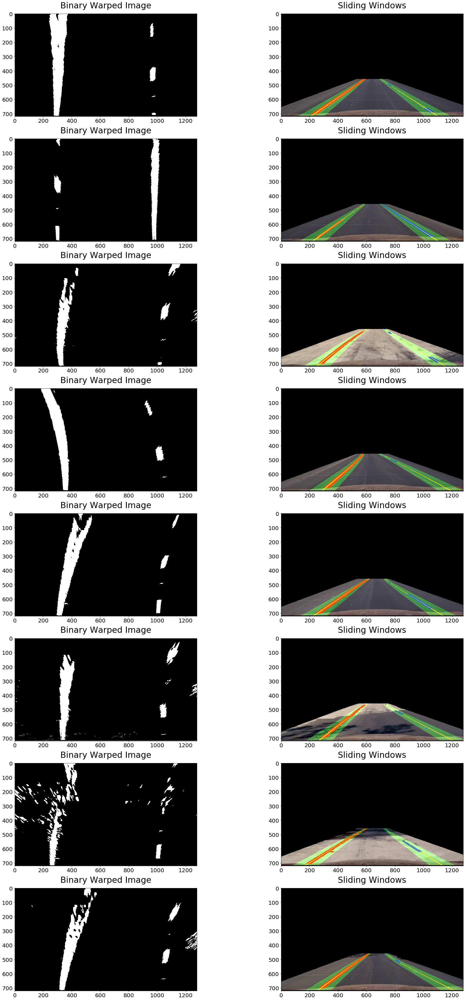

In [36]:
n=8
test_images=os.listdir("test_images/")
titles = ["Binary Warped Image",  "Sliding Windows"]
fig, ax = plt.subplots(n,2,figsize=(30,50))

for i in range(0, n):
    image = mpimg.imread("test_images/"+test_images[i])
    undist = undistort_image(image)
    warped_undist=cv2.warpPerspective(undist, M, undist.shape[1::-1], flags=cv2.INTER_LINEAR)
    filtered = apply_filter(undist)
    warped = cv2.warpPerspective(filtered, M, filtered.shape[1::-1], flags=cv2.INTER_LINEAR)
    left_fit,right_fit = fit_polynomial_windows(warped)
    ax[i][0].imshow(warped ,'gray')
    ax[i][0].set_title(titles[0], fontsize=30)
    left_fit,right_fit = fit_polynomial_windows(warped)
    left_lane_inds, right_lane_inds, left_fitx, right_fitx, ploty = search_around_polynomial(warped,left_fit,right_fit)
    canvas = np.dstack((warped, warped, warped))*255
    poly_img = visualize_polynomials(warped_undist, warped, left_lane_inds, right_lane_inds, left_fitx, right_fitx, ploty)
    img_reverse = cv2.warpPerspective(poly_img, M, poly_img.shape[1::-1], flags=cv2.INTER_LINEAR+cv2.WARP_INVERSE_MAP)
    ax[i][1].imshow(img_reverse ,'gray')
    ax[i][1].set_title(titles[1], fontsize=30)
plt.tight_layout()
plt.show()

We may also try sliding windows by convolution:

In [37]:
# window settings
window_width = 100 
window_height = 80

In [38]:
def window_mask(width, height, img_ref, center,level):
    output = np.zeros_like(img_ref)
    output[int(img_ref.shape[0]-(level+1)*height):int(img_ref.shape[0]-level*height),max(0,int(center-width/2)):min(int(center+width/2),img_ref.shape[1])] = 1
    return output

def find_window_centroids(image, window_width, window_height, margin):
    
    window_centroids = [] # Store the (left,right) window centroid positions per level
    window = np.ones(window_width) # Create our window template that we will use for convolutions
    
    # First find the two starting positions for the left and right lane by using np.sum to get the vertical image slice
    # and then np.convolve the vertical image slice with the window template 
    
    # Sum quarter bottom of image to get slice, could use a different ratio
    l_sum = np.sum(image[int(3*image.shape[0]/4):,:int(image.shape[1]/2)], axis=0)
    l_center = np.argmax(np.convolve(window,l_sum))-window_width/2
    r_sum = np.sum(image[int(3*image.shape[0]/4):,int(image.shape[1]/2):], axis=0)
    r_center = np.argmax(np.convolve(window,r_sum))-window_width/2+int(image.shape[1]/2)
    
    # Add what we found for the first layer
    window_centroids.append((l_center,r_center))
    
    # Go through each layer looking for max pixel locations
    for level in range(1,(int)(image.shape[0]/window_height)):
        # convolve the window into the vertical slice of the image
        image_layer = np.sum(image[int(image.shape[0]-(level+1)*window_height):int(image.shape[0]-level*window_height),:], axis=0)
        conv_signal = np.convolve(window, image_layer)
        # Find the best left centroid by using past left center as a reference
        # Use window_width/2 as offset because convolution signal reference is at right side of window, not center of window
        offset = window_width/2
        l_min_index = int(max(l_center+offset-margin,0))
        l_max_index = int(min(l_center+offset+margin,image.shape[1]))
        l_center = np.argmax(conv_signal[l_min_index:l_max_index])+l_min_index-offset
        # Find the best right centroid by using past right center as a reference
        r_min_index = int(max(r_center+offset-margin,0))
        r_max_index = int(min(r_center+offset+margin,image.shape[1]))
        r_center = np.argmax(conv_signal[r_min_index:r_max_index])+r_min_index-offset
       # Add what we found for that layer
        window_centroids.append((l_center,r_center))

    return window_centroids

In [39]:
def plot_windows(warped):
    window_centroids = find_window_centroids(warped, window_width, window_height, window_margin)
    # If we found any window centers
    if len(window_centroids) > 0:
        # Points used to draw all the left and right windows
        l_points = np.zeros_like(warped)
        r_points = np.zeros_like(warped)

        # Go through each level and draw the windows 	
        for level in range(0,len(window_centroids)):
            # Window_mask is a function to draw window areas
            l_mask = window_mask(window_width,window_height,warped,window_centroids[level][0],level)
            r_mask = window_mask(window_width,window_height,warped,window_centroids[level][1],level)
            # Add graphic points from window mask here to total pixels found 
            l_points[(l_points == 255) | ((l_mask == 1) ) ] = 255
            r_points[(r_points == 255) | ((r_mask == 1) ) ] = 255

        # Draw the results
        template = np.array(r_points+l_points,np.uint8) # add both left and right window pixels together
        zero_channel = np.zeros_like(template) # create a zero color channel
        template = np.array(cv2.merge((zero_channel,template,zero_channel)),np.uint8) # make window pixels green
        warpage= np.dstack((warped, warped, warped))*255 # making the original road pixels 3 color channels
        output = cv2.addWeighted(warpage, 1, template, 0.5, 0.0) # overlay the orignal road image with window results
    # If no window centers found, just display orginal road image
    else:
        output = np.array(cv2.merge((warped,warped,warped)),np.uint8)
    return output

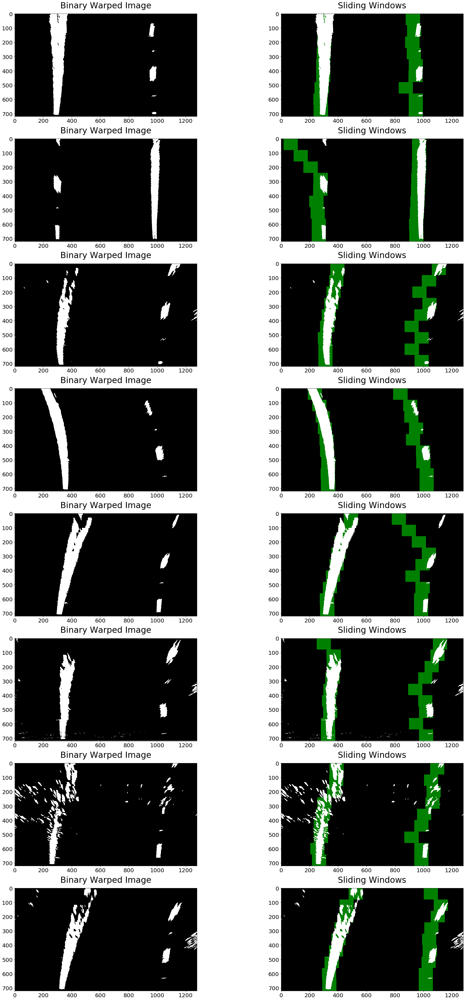

In [40]:
n=8
test_images=os.listdir("test_images/")
titles = ["Binary Warped Image",  "Sliding Windows"]
fig, ax = plt.subplots(n,2,figsize=(30,50))



for i in range(0, n):
    image = mpimg.imread("test_images/"+test_images[i])
    filtered = apply_filter(image)
    warped = cv2.warpPerspective(filtered, M, filtered.shape[1::-1], flags=cv2.INTER_LINEAR)
    ax[i][0].imshow(warped ,'gray')
    ax[i][0].set_title(titles[0], fontsize=30)
    out_img = plot_windows(warped)
    ax[i][1].imshow(out_img ,'gray')
    ax[i][1].set_title(titles[1], fontsize=30)    
plt.tight_layout()
plt.show()

From the test images it seems like the previous algorithm to determine the sliding windows is safer.